1. 22년도 train_data 보간 -> 21년도 train_data 복제 => 하나의 데이터로 학습
2. [ds, y] 외의 피쳐는 ds를 활용한 함수 반영만 가능하다면 분기별로 구분

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from prophet import Prophet
from prophet.plot import add_changepoints_to_plot
from prophet.plot import plot_yearly

/opt/homebrew/anaconda3/envs/LG/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


기본 데이터 

In [11]:
train_22 = pd.read_csv('/Users/haylee/Desktop/Desktop/LG_Aimers/해커톤/open/train.csv')
train_22.tail()

,ID,제품,대분류,중분류,소분류,브랜드,2022-01-01,2022-01-02,2022-01-03,2022-01-04,...,2023-03-26,2023-03-27,2023-03-28,2023-03-29,2023-03-30,2023-03-31,2023-04-01,2023-04-02,2023-04-03,2023-04-04
15885,15885,B002-03799-00002,B002-C001-0003,B002-C002-0008,B002-C003-0042,B002-03799,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
15886,15886,B002-03799-00003,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-03799,0,0,0,0,...,0,0,0,3,0,2,4,1,1,3
15887,15887,B002-03799-00004,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-03799,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
15888,15888,B002-03799-00005,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-03799,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
15889,15889,B002-03799-00010,B002-C001-0002,B002-C002-0004,B002-C003-0020,B002-03799,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [12]:
# melt 
train_22_m = train_22.melt(id_vars=['ID', '제품', '대분류', '중분류', '소분류', '브랜드'],
                var_name='ds', value_name='y', ignore_index=True)
train_22_m.tail()

,ID,제품,대분류,중분류,소분류,브랜드,ds,y
7293505,15885,B002-03799-00002,B002-C001-0003,B002-C002-0008,B002-C003-0042,B002-03799,2023-04-04,0
7293506,15886,B002-03799-00003,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-03799,2023-04-04,3
7293507,15887,B002-03799-00004,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-03799,2023-04-04,0
7293508,15888,B002-03799-00005,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-03799,2023-04-04,2
7293509,15889,B002-03799-00010,B002-C001-0002,B002-C002-0004,B002-C003-0020,B002-03799,2023-04-04,0


In [4]:
train_22_m = train_22_m[['ID', 'ds', 'y']]
train_22_m

,ID,ds,y
0,0,2022-01-01,0
1,1,2022-01-01,0
2,2,2022-01-01,0
3,3,2022-01-01,0
4,4,2022-01-01,0
...,...,...,...
7293505,15885,2023-04-04,0
7293506,15886,2023-04-04,3
7293507,15887,2023-04-04,0
7293508,15888,2023-04-04,2


데이터 생성 -> 복제, 보간

In [5]:
train_21 = pd.DataFrame(np.random.randint(0,15890, size=(15890, 365)), columns=pd.date_range('2021-01-01','2021-12-31', freq="D"))
train_21.tail()

,2021-01-01,2021-01-02,2021-01-03,2021-01-04,2021-01-05,2021-01-06,2021-01-07,2021-01-08,2021-01-09,2021-01-10,...,2021-12-22,2021-12-23,2021-12-24,2021-12-25,2021-12-26,2021-12-27,2021-12-28,2021-12-29,2021-12-30,2021-12-31
15885,14108,10937,8871,11108,5145,6502,14607,11203,1871,7670,...,7541,2203,7246,14664,5849,4871,12294,11643,1228,9581
15886,3467,12531,5109,6185,15800,7432,2647,2179,4523,9173,...,538,3644,13004,15806,10982,13821,4081,8590,399,3530
15887,1735,6486,15809,10833,12517,972,1882,13781,12697,6162,...,10722,1446,1829,15607,8606,14289,4089,1327,1323,3937
15888,3636,12804,7884,12004,9505,9633,1270,5983,228,8029,...,8163,11148,2310,1199,2088,5148,4728,10959,15887,8032
15889,15296,9621,1601,14130,11981,10486,10201,4147,5918,11403,...,8382,978,4332,11034,4104,883,13698,9730,14465,6826


In [22]:
train_21.insert(0, 'ID', 0)
train_21.insert(1, '제품', 0)
train_21.insert(2, '대분류', 0)
train_21.insert(3, '중분류', 0)
train_21.insert(3, '소분류', 0)
train_21.insert(3, '브랜드', 0)

In [28]:
train_21 = train_22.iloc[:,0:5]
train_21.tail()

,ID,제품,대분류,중분류,소분류
15885,15885,B002-03799-00002,B002-C001-0003,B002-C002-0008,B002-C003-0042
15886,15886,B002-03799-00003,B002-C001-0003,B002-C002-0008,B002-C003-0044
15887,15887,B002-03799-00004,B002-C001-0003,B002-C002-0008,B002-C003-0044
15888,15888,B002-03799-00005,B002-C001-0003,B002-C002-0008,B002-C003-0044
15889,15889,B002-03799-00010,B002-C001-0002,B002-C002-0004,B002-C003-0020


In [6]:
# 22년도 데이터값으로 복사
train_21 = train_22.iloc[:, 6:371]
train_21.tail()

,2022-01-01,2022-01-02,2022-01-03,2022-01-04,2022-01-05,2022-01-06,2022-01-07,2022-01-08,2022-01-09,2022-01-10,...,2022-12-22,2022-12-23,2022-12-24,2022-12-25,2022-12-26,2022-12-27,2022-12-28,2022-12-29,2022-12-30,2022-12-31
15885,0,0,0,0,0,0,0,0,0,0,...,79,79,78,1,1,1,2,30,30,28
15886,0,0,0,0,0,0,0,0,0,0,...,5,4,3,5,3,5,7,6,1,2
15887,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,1,0,1
15888,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,1,0,1,2,3,2
15889,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [7]:
# 21년도 컬럼명 변경
train_21.columns=pd.date_range('2021-01-01','2021-12-31', freq="D")
train_21.tail()

,2021-01-01,2021-01-02,2021-01-03,2021-01-04,2021-01-05,2021-01-06,2021-01-07,2021-01-08,2021-01-09,2021-01-10,...,2021-12-22,2021-12-23,2021-12-24,2021-12-25,2021-12-26,2021-12-27,2021-12-28,2021-12-29,2021-12-30,2021-12-31
15885,0,0,0,0,0,0,0,0,0,0,...,79,79,78,1,1,1,2,30,30,28
15886,0,0,0,0,0,0,0,0,0,0,...,5,4,3,5,3,5,7,6,1,2
15887,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,1,0,1
15888,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,1,0,1,2,3,2
15889,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# 0을 nan값으로 변경 -> 평균으로 대체 / 선형보간 / 스플라인보간
# 23.02.23 ~ 23.03.28 : 약 92.65%의 상품이 이 기간동안 0임을 알 수 있음 -> nan값으로 변경
replace_train = train_21.loc[:,'2021-02-23':'2021-03-28']
replace_train = replace_train.replace(0, np.NaN)
replace_train.head()

In [9]:
# nan으로 대체한 컬럼을 원본 df에 합치기
train_21.loc[:,'2021-02-23':'2021-03-28'].replace(0, np.NaN)
train_21

,2021-01-01,2021-01-02,2021-01-03,2021-01-04,2021-01-05,2021-01-06,2021-01-07,2021-01-08,2021-01-09,2021-01-10,...,2021-12-22,2021-12-23,2021-12-24,2021-12-25,2021-12-26,2021-12-27,2021-12-28,2021-12-29,2021-12-30,2021-12-31
0,0,0,0,0,0,0,0,0,0,0,...,6,4,3,0,1,0,3,5,0,3
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,1,1,2,2,2,2,1,1,1,2
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,4,0,0,1,1,9,0,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15885,0,0,0,0,0,0,0,0,0,0,...,79,79,78,1,1,1,2,30,30,28
15886,0,0,0,0,0,0,0,0,0,0,...,5,4,3,5,3,5,7,6,1,2
15887,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,1,0,1
15888,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,1,0,1,2,3,2


In [10]:
train_21

,2021-01-01,2021-01-02,2021-01-03,2021-01-04,2021-01-05,2021-01-06,2021-01-07,2021-01-08,2021-01-09,2021-01-10,...,2021-12-22,2021-12-23,2021-12-24,2021-12-25,2021-12-26,2021-12-27,2021-12-28,2021-12-29,2021-12-30,2021-12-31
0,0,0,0,0,0,0,0,0,0,0,...,6,4,3,0,1,0,3,5,0,3
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,1,1,2,2,2,2,1,1,1,2
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,4,0,0,1,1,9,0,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15885,0,0,0,0,0,0,0,0,0,0,...,79,79,78,1,1,1,2,30,30,28
15886,0,0,0,0,0,0,0,0,0,0,...,5,4,3,5,3,5,7,6,1,2
15887,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,1,0,1
15888,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,1,0,1,2,3,2


In [10]:
train_21['ID'] = train_21.index
train_21.tail()

,2021-01-01 00:00:00,2021-01-02 00:00:00,2021-01-03 00:00:00,2021-01-04 00:00:00,2021-01-05 00:00:00,2021-01-06 00:00:00,2021-01-07 00:00:00,2021-01-08 00:00:00,2021-01-09 00:00:00,2021-01-10 00:00:00,...,2021-12-23 00:00:00,2021-12-24 00:00:00,2021-12-25 00:00:00,2021-12-26 00:00:00,2021-12-27 00:00:00,2021-12-28 00:00:00,2021-12-29 00:00:00,2021-12-30 00:00:00,2021-12-31 00:00:00,ID
15885,0,0,0,0,0,0,0,0,0,0,...,79,78,1,1,1,2,30,30,28,15885
15886,0,0,0,0,0,0,0,0,0,0,...,4,3,5,3,5,7,6,1,2,15886
15887,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,1,1,0,1,15887
15888,0,0,0,0,0,0,0,0,0,0,...,0,1,0,1,0,1,2,3,2,15888
15889,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,15889


In [11]:
# melt 
train_21_m = train_21.melt(id_vars=['ID'], var_name='ds', value_name='y', ignore_index=True)

In [12]:
##1 평균으로 대체
train_21_m['y'].fillna(train_21_m['y'].mean())

0           0
1           0
2           0
3           0
4           0
           ..
5799845    28
5799846     2
5799847     1
5799848     2
5799849     0
Name: y, Length: 5799850, dtype: int64

In [13]:
train_21_m.isnull().sum()

ID    0
ds    0
y     0
dtype: int64

In [14]:
train_21_m

,ID,ds,y
0,0,2021-01-01,0
1,1,2021-01-01,0
2,2,2021-01-01,0
3,3,2021-01-01,0
4,4,2021-01-01,0
...,...,...,...
5799845,15885,2021-12-31,28
5799846,15886,2021-12-31,2
5799847,15887,2021-12-31,1
5799848,15888,2021-12-31,2


학습용 데이터 merge
- 21년도 데이터 : df
- 22년도 데이터 : train_data

In [15]:
# concat
train = pd.concat([train_21_m, train_22_m], axis = 0)

In [16]:
train

,ID,ds,y
0,0,2021-01-01 00:00:00,0
1,1,2021-01-01 00:00:00,0
2,2,2021-01-01 00:00:00,0
3,3,2021-01-01 00:00:00,0
4,4,2021-01-01 00:00:00,0
...,...,...,...
7293505,15885,2023-04-04,0
7293506,15886,2023-04-04,3
7293507,15887,2023-04-04,0
7293508,15888,2023-04-04,2


In [20]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 13093360 entries, 0 to 7293509
Data columns (total 3 columns):
 #   Column  Dtype 
---  ------  ----- 
 0   ID      int64 
 1   ds      object
 2   y       int64 
dtypes: int64(2), object(1)
memory usage: 399.6+ MB


In [17]:
train['ds'] = pd.to_datetime(train['ds'])

In [22]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 13093360 entries, 0 to 7293509
Data columns (total 3 columns):
 #   Column  Dtype         
---  ------  -----         
 0   ID      int64         
 1   ds      datetime64[ns]
 2   y       int64         
dtypes: datetime64[ns](1), int64(2)
memory usage: 399.6 MB


In [ ]:
# merge 안써도 될듯
'''train = pd.merge(train_21_m, train_22_m, on=['ID'], how='inner')
train.tail()'''

### 파라미터 수정하기 전

In [18]:
def train_test_split(train_s, date :str):

    val_s = train_s[train_s.ds >= date]
    train_s = train_s[train_s.ds < date]
    
    train_s['ds'] = pd.to_datetime(train_s['ds'])
    val_s['ds'] = pd.to_datetime(val_s['ds'])

    return train_s, val_s

In [19]:
def make_model():
    
    m = Prophet(changepoint_range=0.9, changepoint_prior_scale=0.5)
    
    m.add_seasonality(name='yearly', period=365.25, fourier_order=10, prior_scale=10, mode='additive')
    m.add_seasonality(name='monthly', period=30.5, fourier_order=5, prior_scale=10, mode='additive')
    m.add_seasonality(name='weekly', period=7, fourier_order=3, prior_scale=10, mode='additive')
    
    return m

In [21]:
def mae():
    
    t = (forecast[forecast.ds >= '2023-01-01']
         .loc[:, ['ds', 'yhat']]
         .merge(val_s)
    )

    t['yhat'] = t.apply(lambda x: x.yhat -2, axis=1)
    t['se'] = np.abs(t.yhat - t.y)
    
    return t['se'].mean()

In [22]:
def plot_forecast():
    
    t = (forecast
        .loc[:, ['ds', 'yhat']]
        .merge(train_s)
    )
    
    t['yhat'] = t.apply(lambda x: x.yhat -2, axis=1)
    t['se'] = np.abs(t.yhat - t.y)

    plt.scatter(t['ds'], t['y'], s=10)
    plt.scatter(t['ds'], t['yhat'], s=10)

/var/folders/2z/r9xljyt96_z0gyfcst5dz1lw0000gn/T/ipykernel_2115/4250148939.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_s['ds'] = pd.to_datetime(train_s['ds'])
/var/folders/2z/r9xljyt96_z0gyfcst5dz1lw0000gn/T/ipykernel_2115/4250148939.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val_s['ds'] = pd.to_datetime(val_s['ds'])
01:13:48 - cmdstanpy - INFO - Chain [1] start processing
01:13:48 - cmdstanpy - INFO - Chain [1] done processing
/var/folders/2z/r9xljyt96_z0gyfcst5dz1lw0000gn/T/ipykerne

,824,825,826,827,828,829,830,831,832,833,...,835,836,837,838,839,840,841,842,843,844
0,0,0,0,0,0,0,0,1,1,0,...,0,0,0,1,1,1,1,1,1,1
1,3,3,3,3,3,4,4,4,4,4,...,4,5,5,5,5,5,5,5,4,4
2,8,9,9,10,10,11,12,12,12,11,...,8,8,7,7,7,6,6,5,4,3
3,18,19,19,19,20,22,25,26,25,23,...,18,17,16,14,13,12,11,10,9,7
4,8,9,8,6,4,4,6,7,8,8,...,8,9,11,12,13,11,9,6,5,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15885,2,6,6,5,3,0,0,0,5,10,...,17,13,11,13,15,16,16,13,5,0
15886,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,1,1,0,0,0,0
15887,16,17,17,17,17,17,16,15,15,14,...,14,13,12,12,11,11,9,9,8,7
15888,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


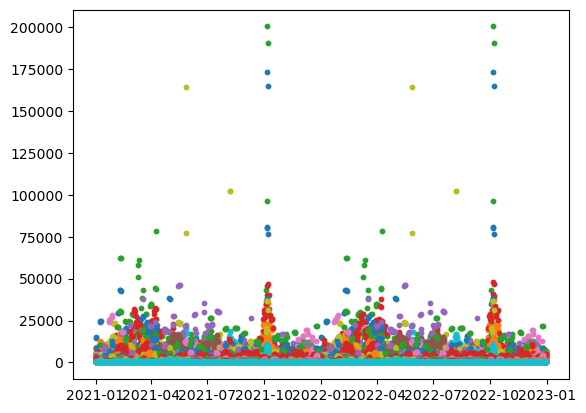

In [23]:
list_tmp_df = []

# ID 순서대로 반복문 실행
for i in range(0, 15890):
    # ID에 해당하는 데이터프레임에서 수치형 컬럼만 가져오기
    train_s = train.loc[train['ID'] == i].loc[:, ['ds', 'y']]

    # train, validation 데이터 분리하기
    train_s, val_s = train_test_split(train_s, '2023-01-01')
    
    # 모델 생성, 학습
    m = make_model()
    # m.fit(train_s)
    if train_s.shape[0] > 2:
        m.fit(train_s)
    else:
        pass

    # 모델 예측값 생성하기, future -> Regressor 추가
    future = m.make_future_dataframe(periods=115)
    forecast = m.predict(future)

    # 예측값이 생성된 forecast에 0이하인 값은 0으로 대체하기
    forecast.yhat = np.where(forecast.yhat < 0, 0, forecast.yhat)

    # mae, plot 확인하기
    metric = mae()
    plot_forecast()

    # 데이터프레임 형식으로 concat하기
    df = forecast[forecast.ds >= '2023-04-05'].loc[:, ['ds', 'yhat']].T
    df = df.drop(df.index[0])
    df = df.round(0).astype(int)
    list_tmp_df.append(df)

predict_df = pd.concat(list_tmp_df, ignore_index=True)
predict_df

In [ ]:

''' 
    파라미터 수정함 -> 다른 요소들에 비해서 확연히 적은 영향이니까 수정 해보기
    m.add_seasonality(name='yearly', period=365.25, fourier_order=3, prior_scale=0.1, mode='additive')
    m.add_seasonality(name='monthly', period=30.5, fourier_order=3, prior_scale=0.1, mode='additive')
    m.add_seasonality(name='weekly', period=7, fourier_order=3, prior_scale=0.1, mode='additive')
'''

In [24]:
# concat 데이터 csv파일로 저장하기
predict_df.to_csv('/Users/haylee/Desktop/Desktop/LG_Aimers/해커톤/제출파일/submission5.csv', header=True, index=False)

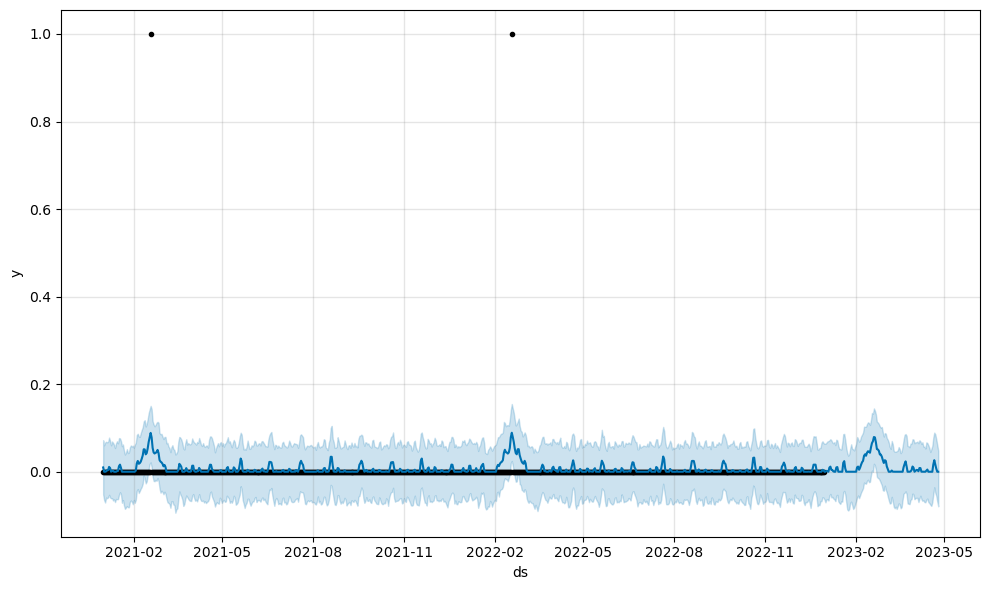

In [26]:
fig1 = m.plot(forecast)

In [ ]:
# 검정이 실제 데이터, 파란색 실선은 트렌드, 검은색 없는 마지막 부분이 예측 데이터

### 파라미터 수정 후(seasonality 줄이고, holidays 반영, 데이터 1년치만 반영)

In [2]:
# 1년치 데이터만 보간작업해서 학습

train = pd.read_csv('/Users/haylee/Desktop/Desktop/LG_Aimers/해커톤/open/train.csv')
train.head()

,ID,제품,대분류,중분류,소분류,브랜드,2022-01-01,2022-01-02,2022-01-03,2022-01-04,...,2023-03-26,2023-03-27,2023-03-28,2023-03-29,2023-03-30,2023-03-31,2023-04-01,2023-04-02,2023-04-03,2023-04-04
0,0,B002-00001-00001,B002-C001-0002,B002-C002-0007,B002-C003-0038,B002-00001,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,B002-00002-00001,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,1,3,2,0,0,2,0
2,2,B002-00002-00002,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,B002-00002-00003,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,B002-00003-00001,B002-C001-0001,B002-C002-0001,B002-C003-0003,B002-00003,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [3]:
# # 02.23 ~ 03.28 : 약 92.65%의 상품이 이 기간동안 0임을 알 수 있음 -> nan값으로 변경
train.loc[:,'2022-02-23':'2022-03-28'].replace(0, np.NaN)
train.head()

,ID,제품,대분류,중분류,소분류,브랜드,2022-01-01,2022-01-02,2022-01-03,2022-01-04,...,2023-03-26,2023-03-27,2023-03-28,2023-03-29,2023-03-30,2023-03-31,2023-04-01,2023-04-02,2023-04-03,2023-04-04
0,0,B002-00001-00001,B002-C001-0002,B002-C002-0007,B002-C003-0038,B002-00001,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1,B002-00002-00001,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,1,3,2,0,0,2,0
2,2,B002-00002-00002,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,B002-00002-00003,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,4,B002-00003-00001,B002-C001-0001,B002-C002-0001,B002-C003-0003,B002-00003,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [4]:
train_m = train.melt(id_vars=['ID', '제품', '대분류', '중분류', '소분류', '브랜드'],
                var_name='ds', value_name='y', ignore_index=True)

In [5]:
##1 평균으로 대체
train_m['y'].fillna(train_m['y'].mean())


0          0
1          0
2          0
3          0
4          0
          ..
7293505    0
7293506    3
7293507    0
7293508    2
7293509    0
Name: y, Length: 7293510, dtype: int64

In [6]:
train_m.head()

,ID,제품,대분류,중분류,소분류,브랜드,ds,y
0,0,B002-00001-00001,B002-C001-0002,B002-C002-0007,B002-C003-0038,B002-00001,2022-01-01,0
1,1,B002-00002-00001,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,2022-01-01,0
2,2,B002-00002-00002,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,2022-01-01,0
3,3,B002-00002-00003,B002-C001-0003,B002-C002-0008,B002-C003-0044,B002-00002,2022-01-01,0
4,4,B002-00003-00001,B002-C001-0001,B002-C002-0001,B002-C003-0003,B002-00003,2022-01-01,0


In [7]:
def train_test_split(train_s, date :str):

    val_s = train_s[train_s.ds >= date]
    train_s = train_s[train_s.ds < date]
    
    train_s['ds'] = pd.to_datetime(train_s['ds'])
    val_s['ds'] = pd.to_datetime(val_s['ds'])

    return train_s, val_s

In [8]:
def make_model2():
    
    # 0.05 기본치 높이면 과적합 우려가 있으니 0.3으로 조정, 이벤트와 공식 휴일에 대해 같이 적용(1. 등록된 공휴일 / 2. 비정기적인 이벤트)
    m = Prophet(holidays = holidays, changepoint_range=0.9, changepoint_prior_scale=0.3) # 2번

    # 파라미터 수정함 -> 다른 요소들에 비해서 확연히 적은 영향이니까 수정 해보기
    m.add_seasonality(name='yearly', period=365.25, fourier_order=3, prior_scale=0.1, mode='additive')
    m.add_seasonality(name='monthly', period=30.5, fourier_order=3, prior_scale=0.1, mode='additive')
    m.add_seasonality(name='weekly', period=7, fourier_order=3, prior_scale=0.1, mode='additive') # 1번
    m.add_country_holidays(country_name='KR') # 1번
    
    return m

In [9]:
def mae():
    
    t = (forecast[forecast.ds >= '2023-01-01']
         .loc[:, ['ds', 'yhat']]
         .merge(val_s)
    )

    t['yhat'] = t.apply(lambda x: x.yhat -2, axis=1)
    t['se'] = np.abs(t.yhat - t.y)
    
    return t['se'].mean()

In [10]:
def plot_forecast():
    
    t = (forecast
        .loc[:, ['ds', 'yhat']]
        .merge(train_s)
    )
    
    t['yhat'] = t.apply(lambda x: x.yhat -2, axis=1)
    t['se'] = np.abs(t.yhat - t.y)

    plt.scatter(t['ds'], t['y'], s=10)
    plt.scatter(t['ds'], t['yhat'], s=10)

In [11]:
list_tmp_df2 = []

holidays = pd.DataFrame({
  'holiday': 'event',
  'ds': pd.to_datetime(['2022-07-10','2022-07-18','2022-07-26',
                        '2022-08-16','2022-08-22','2022-08-30',
                        '2022-11-06']),
  'lower_window': -5,
  'upper_window': 5,
})

/var/folders/2z/r9xljyt96_z0gyfcst5dz1lw0000gn/T/ipykernel_24210/4250148939.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_s['ds'] = pd.to_datetime(train_s['ds'])
/var/folders/2z/r9xljyt96_z0gyfcst5dz1lw0000gn/T/ipykernel_24210/4250148939.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val_s['ds'] = pd.to_datetime(val_s['ds'])
01:24:43 - cmdstanpy - INFO - Chain [1] start processing
01:24:43 - cmdstanpy - INFO - Chain [1] done processing
/var/folders/2z/r9xljyt96_z0gyfcst5dz1lw0000gn/T/ipyker

,459,460,461,462,463,464,465,466,467,468,...,470,471,472,473,474,475,476,477,478,479
0,3,3,2,2,2,3,3,3,3,3,...,2,2,2,3,3,3,3,3,3,3
1,2,2,2,2,2,2,2,2,3,3,...,2,2,2,3,3,3,3,3,2,2
2,4,4,5,6,7,7,7,7,7,6,...,6,5,5,4,5,5,5,5,5,5
3,8,9,10,12,14,15,15,14,14,12,...,11,9,8,6,8,8,10,10,9,8
4,6,6,7,4,2,0,0,0,2,4,...,4,3,4,3,4,4,2,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17535,30,34,37,38,40,33,24,25,34,43,...,56,51,42,39,41,42,40,41,33,23
17536,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
17537,16,17,17,16,16,15,15,15,15,15,...,14,14,14,14,15,15,13,13,13,12
17538,0,0,0,0,0,0,0,0,1,1,...,1,1,0,1,2,2,2,2,2,1


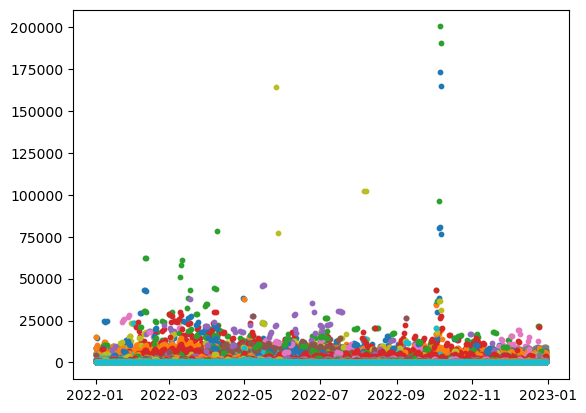

In [16]:
# ID 순서대로 반복문 실행
for i in range(0, 15890):
    # ID에 해당하는 데이터프레임에서 수치형 컬럼만 가져오기
    train_s = train_m.loc[train_m['ID'] == i].loc[:, ['ds', 'y']]

    # train, validation 데이터 분리하기
    train_s, val_s = train_test_split(train_s, '2023-01-01')
    
    # 모델 생성, 학습
    m = make_model2()
    # m.fit(train_s)
    if train_s.shape[0] > 2:
        m.fit(train_s)
    else:
        pass

    # 모델 예측값 생성하기, future -> Regressor 추가
    future = m.make_future_dataframe(periods=115)
    forecast = m.predict(future)

    # 예측값이 생성된 forecast에 0이하인 값은 0으로 대체하기
    forecast.yhat = np.where(forecast.yhat < 0, 0, forecast.yhat)

    # mae, plot 확인하기
    metric = mae()
    plot_forecast()

    # 데이터프레임 형식으로 concat하기
    df = forecast[forecast.ds >= '2023-04-05'].loc[:, ['ds', 'yhat']].T
    df = df.drop(df.index[0])
    df = df.round(0).astype(int)
    list_tmp_df2.append(df)

predict_df = pd.concat(list_tmp_df2, ignore_index=True)
predict_df

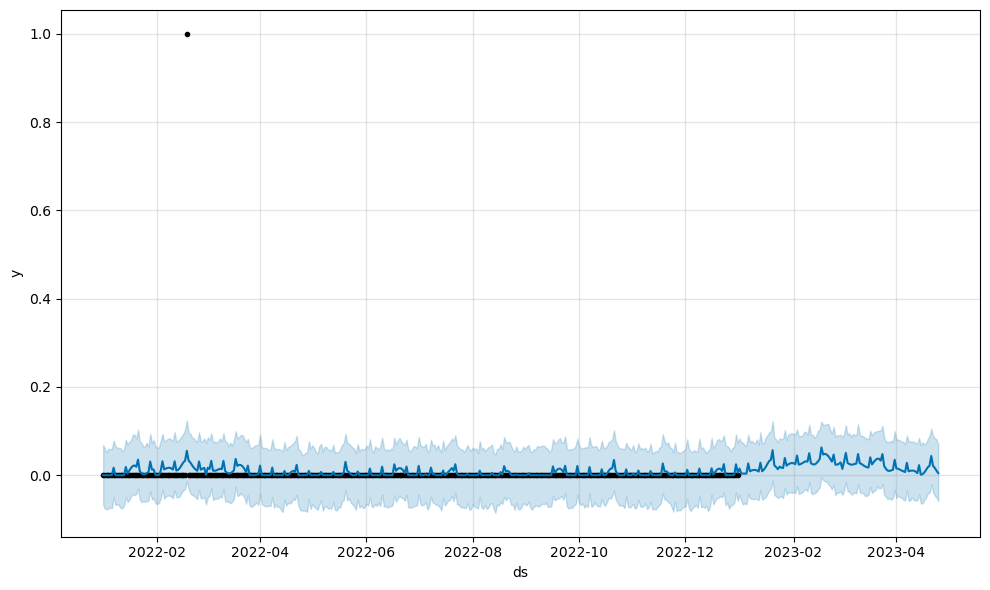

In [17]:
fig2 = m.plot(forecast)

In [18]:
# concat 데이터 csv파일로 저장하기
predict_df.to_csv('/Users/haylee/Desktop/Desktop/LG_Aimers/해커톤/제출파일/submission7.csv', header=True, index=False)